# Chapter 4: Data handling

# Probem Definition:

Bike sharing system is a service in which member or non-member individuals can rent bicycle on a short term duration. This scheme is going popular around the globe. We aim to find out: “ How we can fit a linear model to predict the number of bike rental demands for any kind of potential customer?”, as a part of a Kaggle competition (https://www.kaggle.com/c/bike-sharing-demand).
The bike sharing data (including training and test files) is available at the Kaggle competition website and you can download it  directly from the following url:
https://www.kaggle.com/c/bike-sharing-demand/data

At the first sight the problem looks simple. The main challenge is to structure the data and extract the relevant information.

# Raw Data: 

The goal of this exrcise is to predict the exact number of bicycle demands for customers so that the bike sharing system providers are be able to setup the system and also the users plan their travels more easily.
The data set provided by Kaggle demonstrates a snapshot of hourly rental data over two years (from January 1, 2011 to December 31,2012).

The training data set is for the first 19 days of each month. The remaining days are considered as test data. We aim to predict the total rental bikes counts hourly in test data. The date and time are provided as a string feature in the data set including several important information about the year, month, day of the week and hour. 

In [1]:
library(lubridate)
library(car)  # for scatterplot
library(chron)


Warning message:
: package ‘lubridate’ was built under R version 3.2.4
Attaching package: ‘lubridate’

The following object is masked from ‘package:base’:

    date

Warning message:
: package ‘car’ was built under R version 3.2.4
Attaching package: ‘chron’

The following objects are masked from ‘package:lubridate’:

    days, hours, minutes, seconds, years



In [2]:
# read data:
setwd("~/Dropbox (MAGI)/farnoush-vahid/r-workshop/data/")
train=read.csv("train.csv", stringsAsFactors = FALSE)
test=read.csv("test.csv", stringsAsFactors = FALSE)


The raw data set consists of 10886 records in which each observation consists of 12 attributes with no missing value as follows:

In [3]:
#dataset dimension:
cat("Number of training rows: ", nrow(train), "\n")
cat("Number of training cols: ", ncol(train), "\n")

# columns name"
names(train)

# review data:
head(train)

str(train)

# check for missing values in data:
table(is.na(train))


Number of training rows:  10886 
Number of training cols:  12 


[1] "datetime"   "season"     "holiday"    "workingday" "weather"   
 [6] "temp"       "atemp"      "humidity"   "windspeed"  "casual"    
[11] "registered" "count"

,datetime,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,casual,registered,count
1,2011-01-01 00:00:00,1,0,0,1,9.84,14.395,81,0,3,13,16
2,2011-01-01 01:00:00,1,0,0,1,9.02,13.635,80,0,8,32,40
3,2011-01-01 02:00:00,1,0,0,1,9.02,13.635,80,0,5,27,32
4,2011-01-01 03:00:00,1,0,0,1,9.84,14.395,75,0,3,10,13
5,2011-01-01 04:00:00,1,0,0,1,9.84,14.395,75,0,0,1,1
6,2011-01-01 05:00:00,1,0,0,2,9.84,12.88,75,6.0032,0,1,1


'data.frame':	10886 obs. of  12 variables:
 $ datetime  : chr  "2011-01-01 00:00:00" "2011-01-01 01:00:00" "2011-01-01 02:00:00" "2011-01-01 03:00:00" ...
 $ season    : int  1 1 1 1 1 1 1 1 1 1 ...
 $ holiday   : int  0 0 0 0 0 0 0 0 0 0 ...
 $ workingday: int  0 0 0 0 0 0 0 0 0 0 ...
 $ weather   : int  1 1 1 1 1 2 1 1 1 1 ...
 $ temp      : num  9.84 9.02 9.02 9.84 9.84 ...
 $ atemp     : num  14.4 13.6 13.6 14.4 14.4 ...
 $ humidity  : int  81 80 80 75 75 75 80 86 75 76 ...
 $ windspeed : num  0 0 0 0 0 ...
 $ casual    : int  3 8 5 3 0 0 2 1 1 8 ...
 $ registered: int  13 32 27 10 1 1 0 2 7 6 ...
 $ count     : int  16 40 32 13 1 1 2 3 8 14 ...



 FALSE 
130632 

Raw data features and description are provided by information in Table I as follows:  

|Feature    |Description     |
|--------------------|---------------------------------------|
|1.Date and hour | provided as a single string. |
|2. Season | represented by 1 to 4 (1: spring, 2: summer, 3: fall, 4: winter) |
|3. Holiday | a binary variable representing whether the particular day is a holiday |
|4. Working day | a binary variable representing whether the day is neither a weekend nor holiday |
|5. Weather | a categorical variable with 4 levels representing different weather conditions: 1: Clear, Few clouds, Partly cloudy; 2: Mist ,Cloudy, Broken clouds; 3: Light Rain, Light Snow, Scattered clouds; 4: Heavy Rain , Heavy snow ,Thunderstorm , Fog |
|6. Temp | Hourly temperature in celsius which is continuous data in range of [0.8,41] |
|7. aTemp | the weather feel like in celsius which is in range of [0.7,46] |
|8. Humidity | percentage of weather humidity which is in range of [0,100] |
|9. Windspeed | continues data in range of [0,57] |
|10. Casual | Represents the number of bike rentals made by non-registered users (Y) |
|11. Registered | represents the number of bike rentals made by registered users (Y) |
|12. Count | summation of casual and registered values (the value that we intend to predict (Y) ) |

To understand the distribution of variables, we plot a frequency histogram for each numeric variable and analyze the distribution of and the total demand counts (as target feature) against each variable.

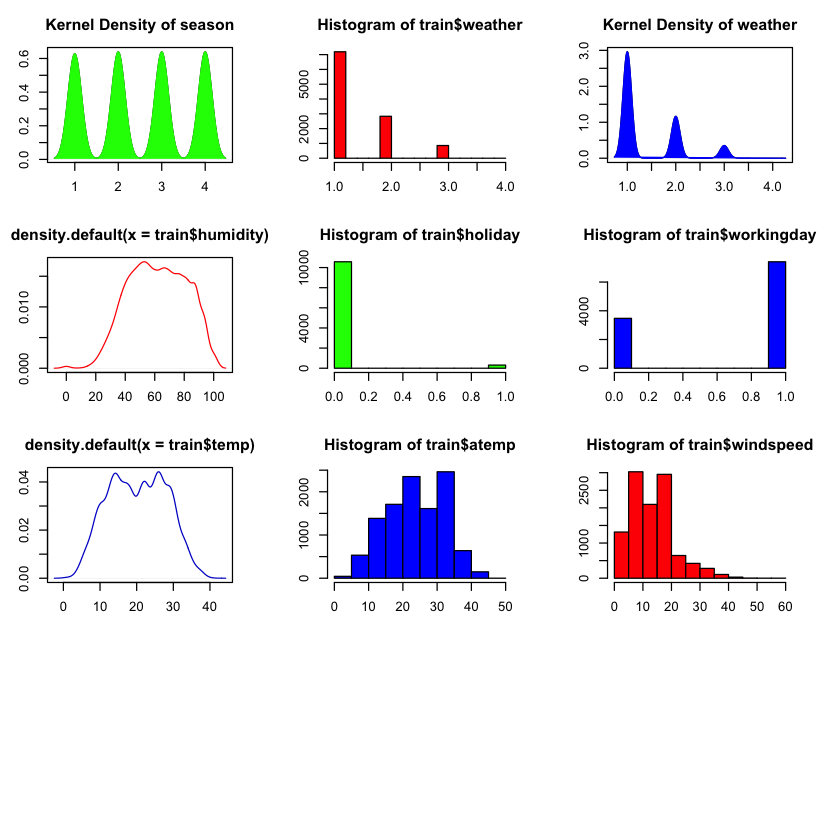

In [4]:
# plot frequency diagrams:
par(mfrow=c(4,3))
par(mar = rep(3, 4))
# Filled Density Plot
d <- density(train$season)
plot(d, main="Kernel Density of season")
polygon(d, col="green", border="green")
hist(train$weather, breaks=12, col="red")
d <- density(train$weather)
plot(d, main="Kernel Density of weather")
polygon(d, col="blue", border="blue")
# Kernel Density Plot
d <- density(train$humidity) # returns the density data 
plot(d, col = "red") # plots the results
hist(train$holiday, breaks=12, col="green")
hist(train$workingday, breaks=12, col="blue")
d <- density(train$temp) # returns the density data 
plot(d, col = "blue3") # plots the results
hist(train$atemp, breaks=12, col="blue1")
hist(train$windspeed, breaks=12, col="red")



# Data Preprocessing:

After deeping dive in the data set, we have the hypothesis that the date and time feature makes the analysis of data difficult. Therefore we convert it into four separate variables:
month, day of week, hour of day and weekend/nonweekend features to have more information and improve the accuracy of our prediction. 
We plot the trend of count over these new features and check whether the hypothesis is correct or not. 

In [5]:
########## feature enginerring#########
# for tranforming datetime  and categorical variables we do as follows:
datetime <- ymd_hms(train$datetime)
train$datetime <- datetime
train$hour <- hour(datetime)
train$day <- as.integer(factor(wday(ymd_hms(train$datetime), label=TRUE), levels = c("Mon", "Tues", "Wed", 
                                                                                     "Thurs", "Fri", "Sat", "Sun"),ordered = TRUE))
train$month <- as.integer(factor(months(datetime) ,levels = c("January"
                                                              ,"February"
                                                              ,"March"
                                                              ,"April"
                                                              ,"May"
                                                              ,"June"
                                                              ,"July"
                                                              ,"August"
                                                              ,"September"
                                                              ,"October"
                                                              ,"November"
                                                              ,"December") ,ordered = TRUE))
train$weekend <- as.integer(factor(is.weekend(train$datetime)), levels = c("TRUE", "FALSE"), ordered = FALSE)




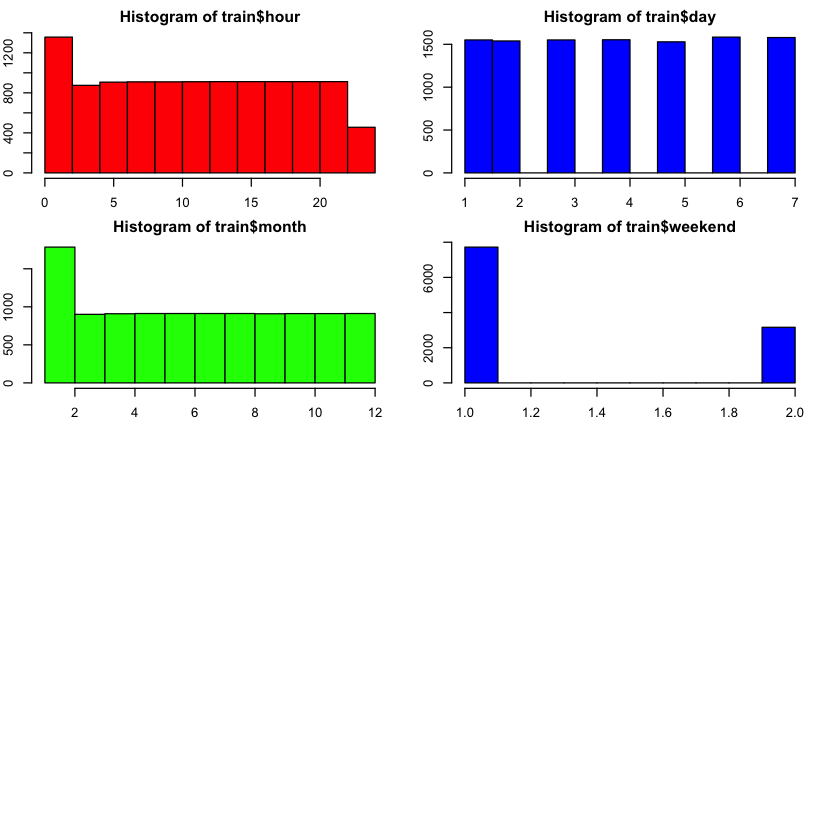

In [6]:
# plot frequency diagrams for new features:
par(mfrow=c(4,2))
par(mar = rep(2, 4))
hist(train$hour, breaks=12, col="red")
hist(train$day, breaks=12, col="blue")
hist(train$month, breaks=12, col="green")
hist(train$weekend, breaks=12, col="blue")


The result obtained by following graphs clearly satisfied our hypothesis.
As understood from following histograms, the season feature has four categories of almost same distribution, and weather attribute with partly cloudy or clear state is more frequent
than other weather conditions.
Furthermore, a considerable number of demands are received on working days compared to the days which are neither a weekend nor holiday.

Next, a Linear Model Regression method is used to predict the exact number of rental bike demands. The algorithm is performed over two different feature combinations, raw data and data with new features, to find the best fitted model. 

Performing linear model on raw data gives the following result:



Call:
lm(formula = count ~ ., data = train[c("season", "holiday", "workingday", 
    "weather", "temp", "atemp", "humidity", "windspeed", "count")])

Residuals:
    Min      1Q  Median      3Q     Max 
-335.81 -102.67  -31.95   66.44  677.02 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept) 135.79052    8.71016  15.590  < 2e-16 ***
season       22.75882    1.42662  15.953  < 2e-16 ***
holiday      -9.15872    9.27009  -0.988 0.323181    
workingday   -1.14953    3.31527  -0.347 0.728795    
weather       5.93872    2.61924   2.267 0.023389 *  
temp          1.84737    1.14210   1.618 0.105796    
atemp         5.63120    1.05057   5.360 8.49e-08 ***
humidity     -3.05684    0.09262 -33.003  < 2e-16 ***
windspeed     0.77762    0.19999   3.888 0.000102 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 155.8 on 10877 degrees of freedom
Multiple R-squared:  0.2609,	Adjusted R-squared:  0.2604 
F-statistic:   4

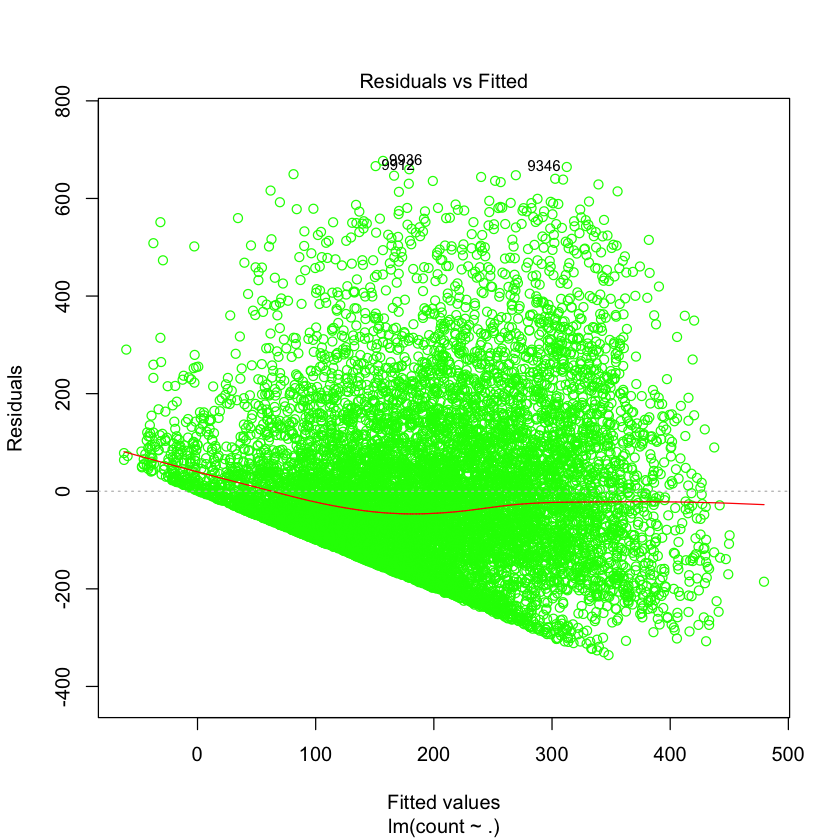

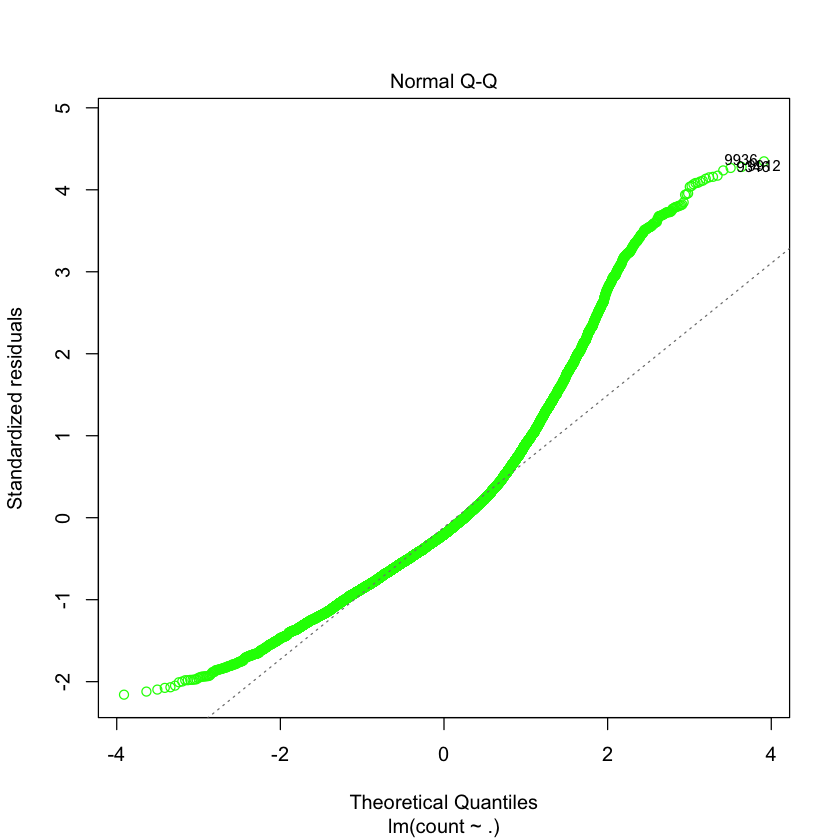

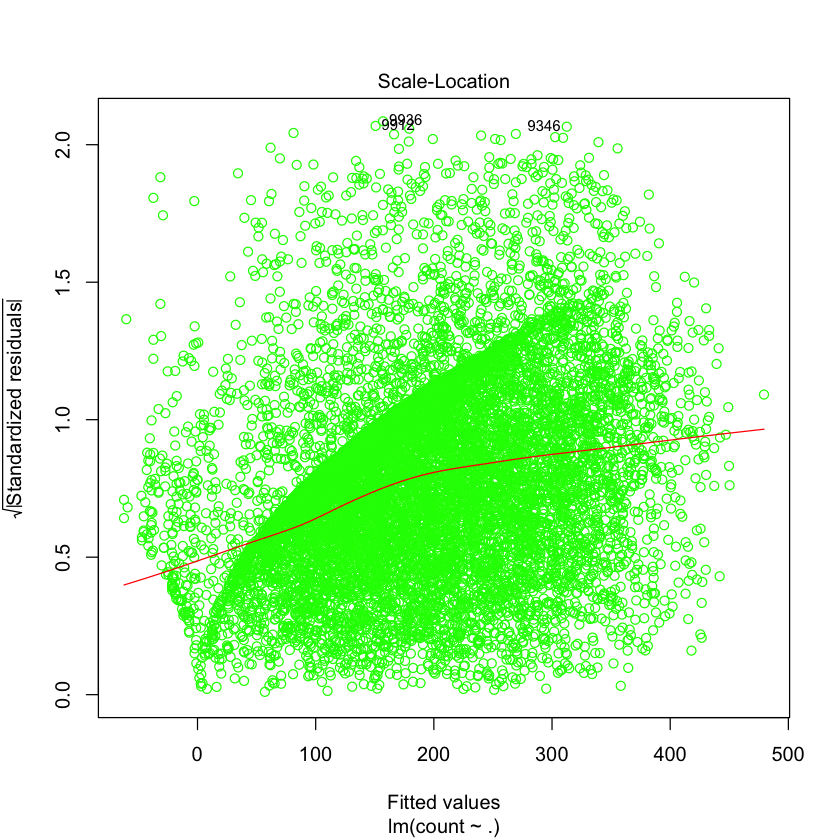

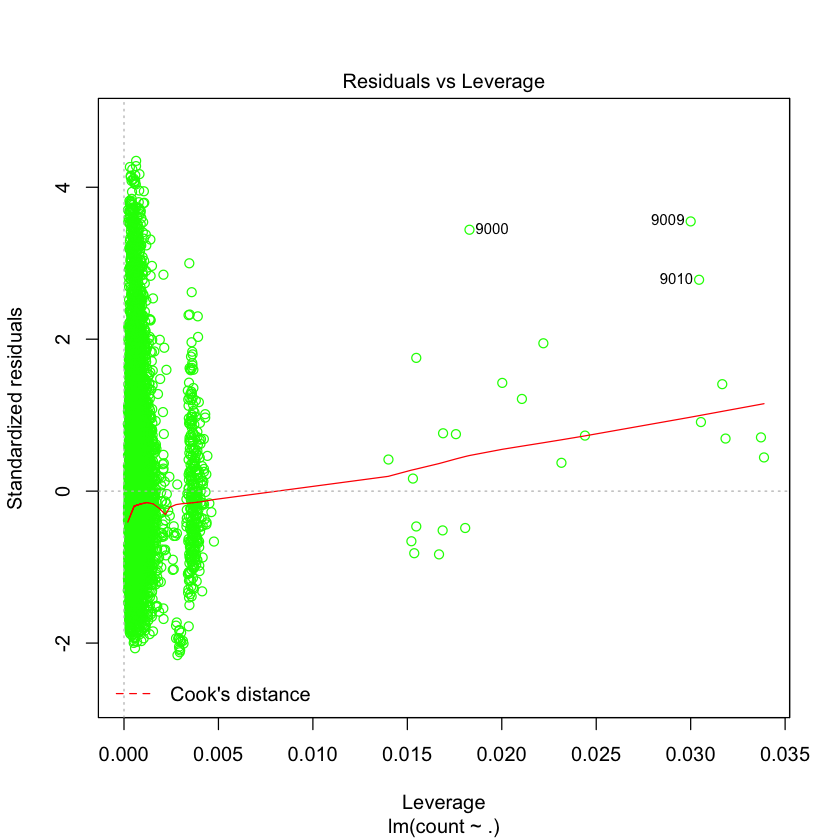

In [7]:
# compare fitted model with linear regression for raw data and data with new features 
lm1 <- lm(count ~ .,data = train[c("season"
                                   ,"holiday"
                                   ,"workingday"
                                   ,"weather"
                                   ,"temp"
                                   ,"atemp"
                                   ,"humidity"
                                   ,"windspeed"
                                   ,"count")])

summary(lm1)
plot(lm1, col = "green")



and running over data with new features yiels to the charts below:



Call:
lm(formula = count ~ ., data = train[c("season", "holiday", "workingday", 
    "weather", "temp", "atemp", "humidity", "windspeed", "hour", 
    "day", "month", "count")])

Residuals:
    Min      1Q  Median      3Q     Max 
-322.04  -96.57  -31.05   55.26  696.31 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 43.75179   12.35756   3.540 0.000401 ***
season      -8.85665    5.39051  -1.643 0.100410    
holiday      1.03406   10.46310   0.099 0.921275    
workingday   2.84828    5.15792   0.552 0.580812    
weather     -2.51477    2.49337  -1.009 0.313197    
temp         2.16989    1.08471   2.000 0.045479 *  
atemp        4.50240    0.99882   4.508 6.62e-06 ***
humidity    -2.27726    0.09124 -24.960  < 2e-16 ***
windspeed    0.37972    0.18995   1.999 0.045629 *  
hour         7.55581    0.21653  34.894  < 2e-16 ***
day          0.85180    1.18439   0.719 0.472037    
month       10.22211    1.75176   5.835 5.52e-09 ***
---
Signif. codes:  0 ‘

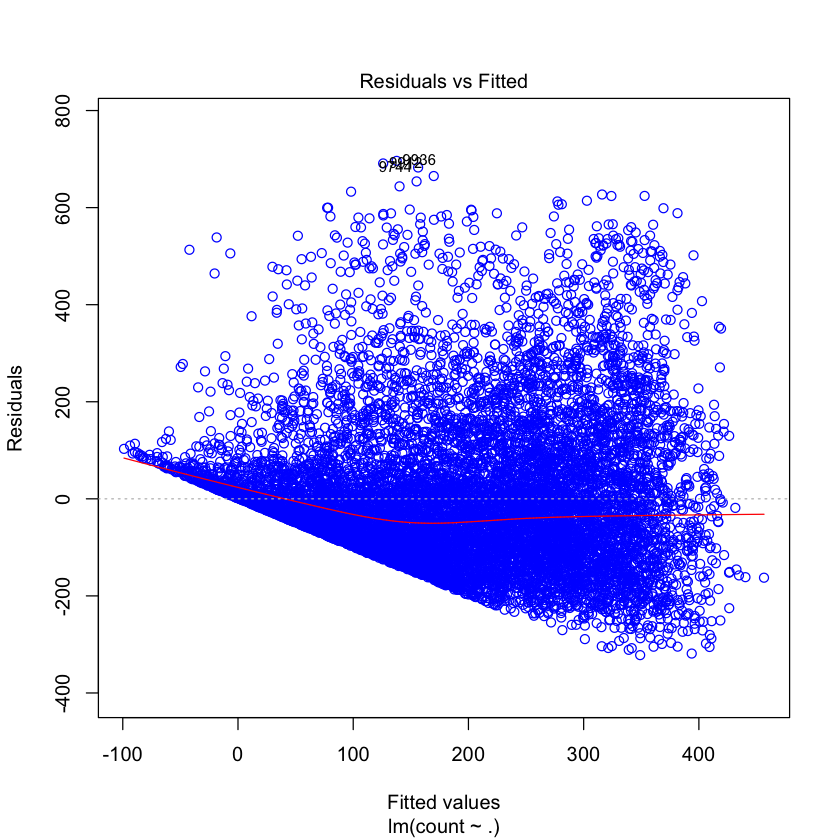

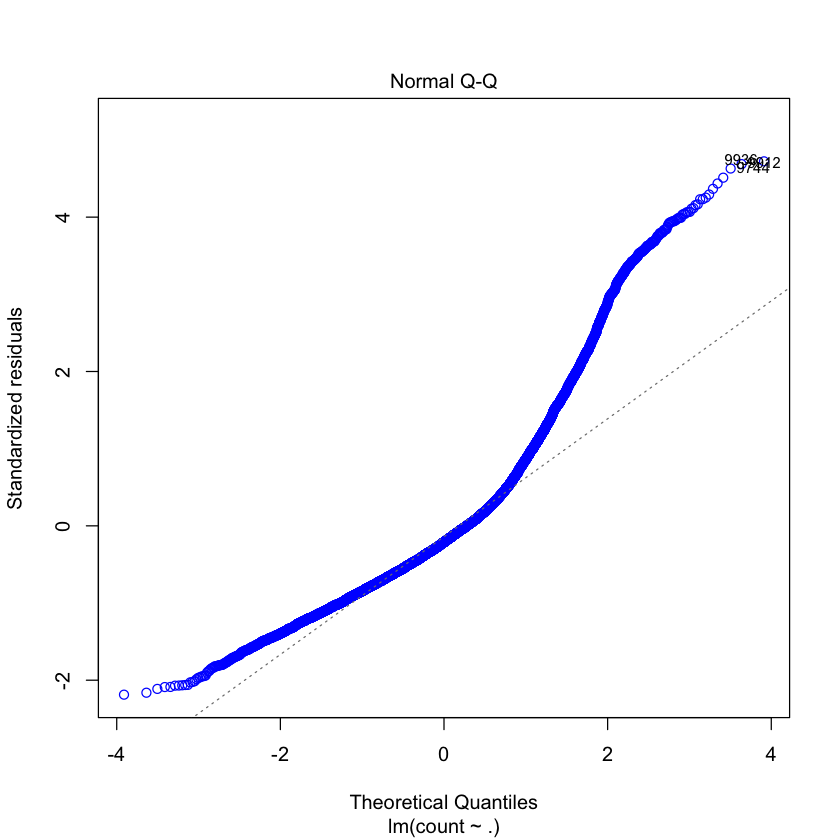

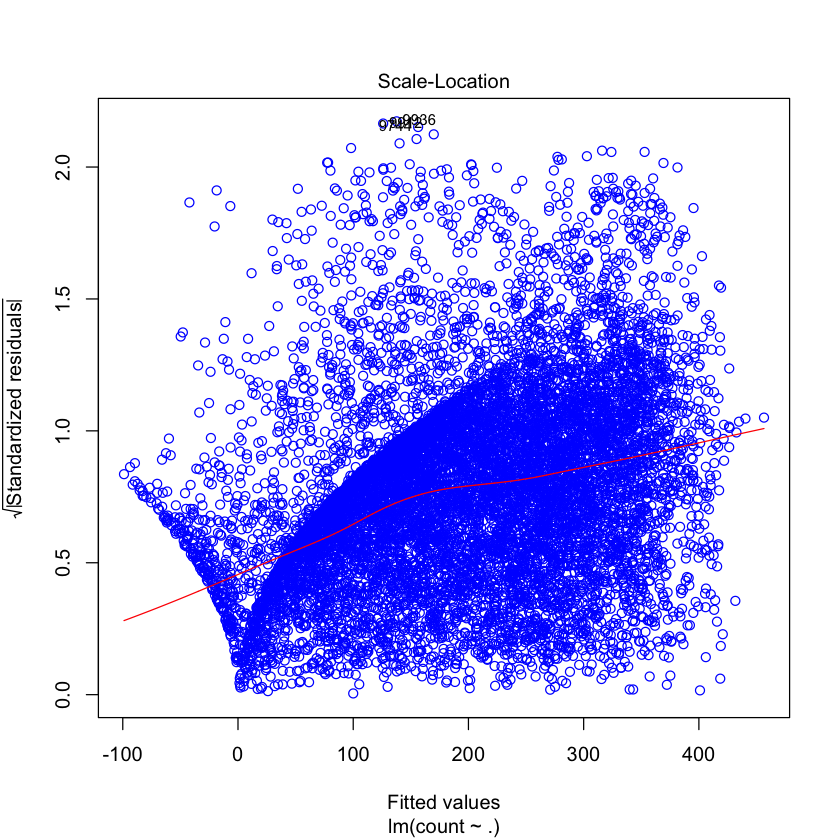

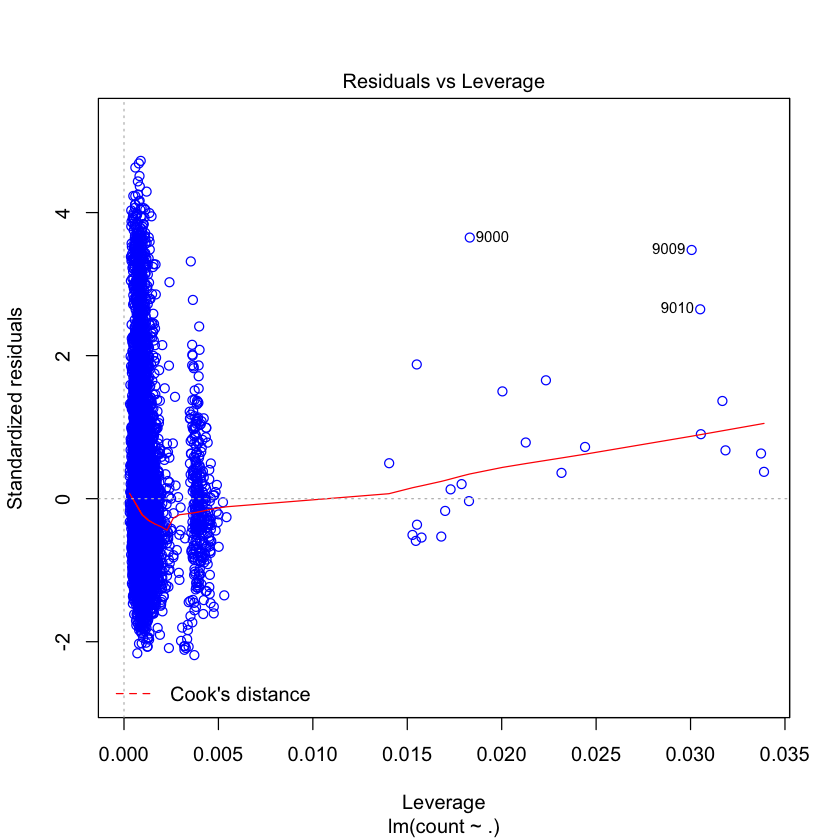

In [8]:
lm2 <- lm(count ~ .,data = train[c("season"
                                   ,"holiday"
                                   ,"workingday"
                                   ,"weather"
                                   ,"temp"
                                   ,"atemp"
                                   ,"humidity"
                                   ,"windspeed"
                                   ,"hour"
                                   ,"day"
                                   ,"month"
                                   ,"count")])
summary(lm2)
plot(lm2, col = "blue")
